<a href="https://colab.research.google.com/github/elsioantunes/proc-video/blob/main/procVideoLab5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Motion Analysis e BackGround Subtraction
Uma boa detecção de primeiro plano deveria ser capaz de obter um modelo estimado de background. Infelizmente não deu tempo. Os estudos que envolvem análise de movimento e máscaras apropriadas, considerando iluminação e artefatos de sombra ocuparam um tempo considerável. Mas valeu o estudo e numa próxima oportunidade, parte do caminho já está trilhado.

In [267]:
import numpy as np
import random as rnd
import cv2 as cv
from base64 import b64encode, b64decode
from google.colab.patches import cv2_imshow
from google.colab import drive
from google.colab.output import eval_js
from IPython.display import HTML, Image, display, Javascript

drive.mount('/content/drive')

def vstack(img1, img2):
    return np.vstack([dim3(img1), dim3(img2)])

def hstack(img1, img2):
    return np.hstack([dim3(img1), dim3(img2)])

def Threshold(img, hsvChan=2, binary=False):
    hsv = cv.cvtColor(img, cv.COLOR_BGR2HSV)
    _, thresh = cv.threshold(cv.split(hsv)[hsvChan], 255, 255, cv.THRESH_TRIANGLE)
    if binary: return thresh
    return dim3(thresh)

def MaskOpen(img, k=10):
    kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(k, k))    
    img = cv.morphologyEx(img, cv.MORPH_OPEN, kernel)
    return img
    
def openVideo(url):
    cap = cv.VideoCapture(url)
    ret, frame = cap.read()
    vheight, vwidth = frame.shape[:2]
    fps = cap.get(cv.CAP_PROP_FPS)
    print("frame count:", cap.get(cv.CAP_PROP_FRAME_COUNT))
    print("width, height, fps:", vwidth, vheight, fps)
    return cap

def show(img, title=""):
    return cv2_imshow(img)

def rndColor():
    r = rnd.randrange(50, 240)
    g = rnd.randrange(50, 240)
    b = rnd.randrange(50, 240)
    return (r, g, b)

def dim3(img):
    if len(img.shape) == 2:
        img = cv.merge([img, img, img])
    return img.astype('uint8')

def overlayAlpha(img1, img2, alpha):
    return cv.addWeighted(img1, alpha, img2, 1-alpha, 0)

def newVideo(outUrl, frame, codec='VP80'):
    fourcc = cv.VideoWriter_fourcc(*codec)
    vheight, vwidth = frame.shape[:2]
    return cv.VideoWriter(outUrl, fourcc, 25, (vwidth, vheight))


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Objetivos:

1. Aplicar uma quantidade de conceitos de processamento de vídeo da disciplina.
 $\color{#DDDD00}{\text{em processo}}$
2.  Executar a aplicação com cenas pré-gravadas, para testes e gravação de “demo”. $\color{#DDDD00}{\text{em processo}}$
3.  Estudar e aplicar os mecanismos de motion detection $\color{#00dd00}{\text{ok}}$
4.  Estudar e aplicar os mecanismos de background extract $\color{#00dd00}{\text{ok}}$


# Abordagem 1 - ConvexHull



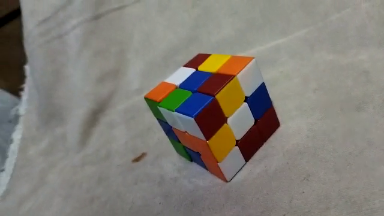

In [168]:
cubeS = cv.imread('/content/drive/MyDrive/((UFABC))/(proc video)/cubeS.png')
show(cubeS)

* Em situações controladas é possivel isolar quase que perfeitamente um objeto. 
* Nesta primeira abordagem vamos tentar destacar o objeto em questão com uma máscara de poligono convexo, aproveitando-se da característica do cubo de ter uma projeção sempre convexa. 
* Outra característica do cubo é ter suas cores bem saturadas em relação a muitos *backgrouds*. O que nos permitiria utilizar do espaço de cores HSV para ajudar no destaque
* com `cv.COLOR_BGR2HSV` e `cv.split` podemos obter o canal s de hsv, que nos fornece saturação de uma cor pura. Observe, no entanto, que os adesivos brancos não são bem representados nesta visualização. Brancos e tons de cinza são representados com valores baixos neste canal.
* De posse desta informação, binarizamos o canal para obter uma máscara de onde extraimos os contornos. 
* O maior (neste caso) contorno encontrado possivelmente é do objeto que queremos destacar. Mas ele tem buracos por causa das áreas não reconhecidas pelo canal de saturação. 
* Aplicando o algoritmo `cv.convexHull()` neste contorno, podemos cobrir estes buracos e construir uma nova máscara para depois aplicar na imagem original, obtendo o objeto isolado


s de hsv


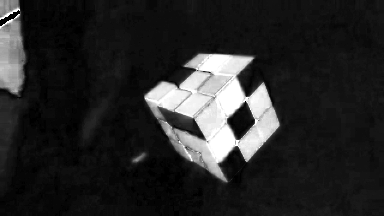

treshold da saturação


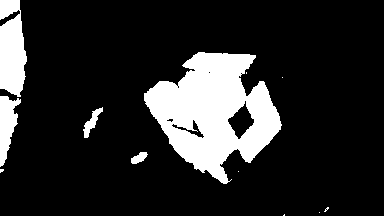

Êis o maior contorno encontrado


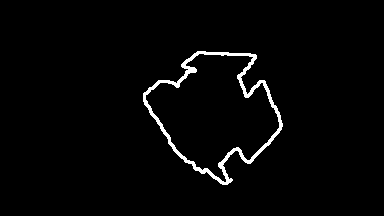

E a envoltória convexa deste contorno


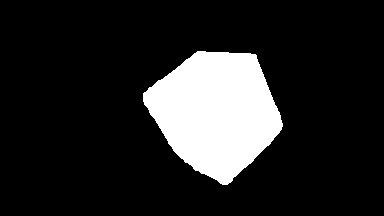

resultando em uma máscara apropriada


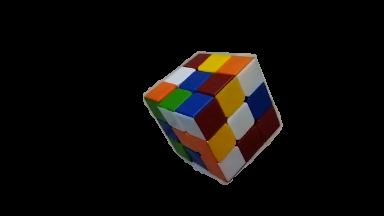

In [219]:
def convexHullMask(orig, debug=False, binary=False):
    hsv = cv.cvtColor(orig, cv.COLOR_BGR2HSV)
    h, s, v = cv.split(hsv)
    if debug: 
        print("s de hsv")
        show(s)

    _, thresh = cv.threshold(s, 255, 255, cv.THRESH_TRIANGLE)
    if debug: 
        print ("treshold da saturação")
        show(thresh)

    contours, _ = cv.findContours(thresh, cv.RETR_LIST, cv.CHAIN_APPROX_SIMPLE)
    mask = np.zeros_like(s)
    cont = max(contours, key=cv.contourArea)
    cv.drawContours(mask, [cont] , 0, 255, 2)
    if debug: 
        print ("Êis o maior contorno encontrado")
        show(mask)

    cv.drawContours(mask, [cv.convexHull(cont)] , 0, 255, -1)
    if debug: 
        print ("E a envoltória convexa deste contorno")
        show(mask)

    if binary: return mask

    masked = cv.bitwise_and(orig, orig, mask=mask)
    if debug: 
        print ("resultando em uma máscara apropriada")
        show(masked)

    return masked


tmp = convexHullMask(cubeS, debug=True)

# Abordagem 2 - convexHull em video


frame count: 243.0
width, height, fps: 640 352 29.446217231490085
frame:0


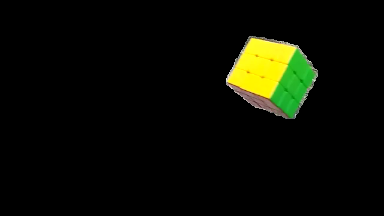

frame:1


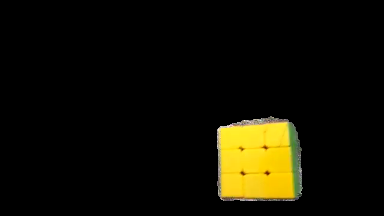

frame:2


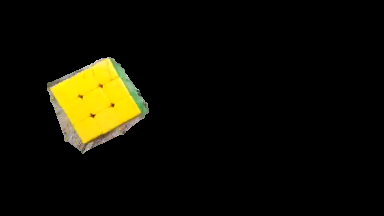

frame:3


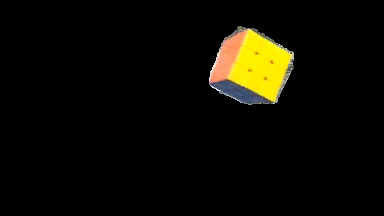

frame:4


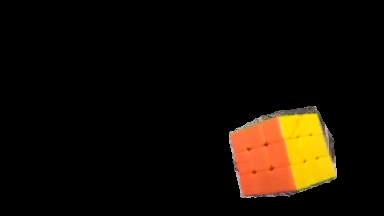

frame:5


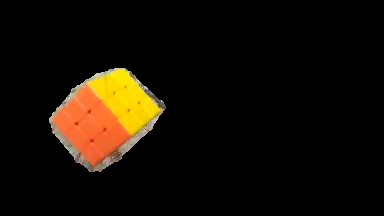

frame:6


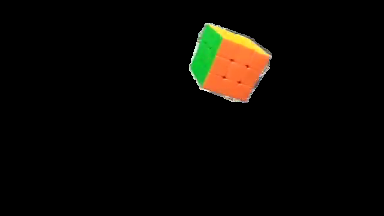

frame:7


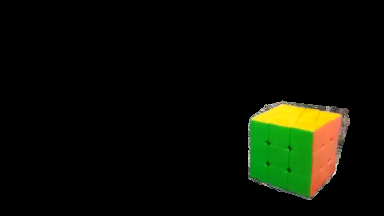

frame:8


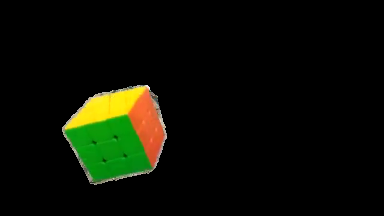

frame:9


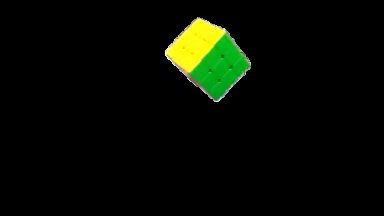

frame:10


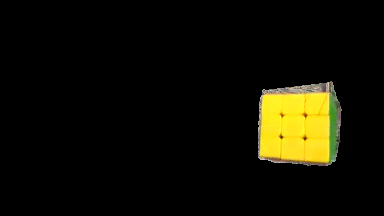

frame:11


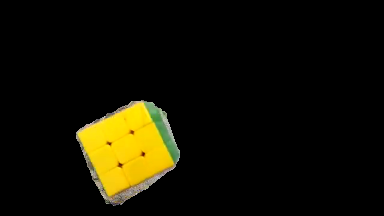

frame:12


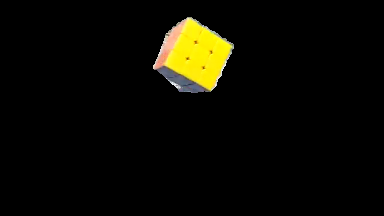

In [210]:
#inUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/cuboPend2.mp4'
inUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/cuboChao.mp4'
outUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/teste.webm'
saida = None
x = 0
i = 0
cap = openVideo(inUrl)

while True:
    ret, atualFrame = cap.read()
    if ret: 
        atualFrame = cv.resize(atualFrame, (384, 216))
        orig = atualFrame.copy()

        atualFrame = convexHullMask(atualFrame)

        frame = vstack(orig, atualFrame) 
        if saida == None:
            saida = newVideo(outUrl, frame)
        saida.write(frame)

        if (x % 20) == 0:
            print (f"frame:{i}")
            show(atualFrame) 
            i = i + 1
        x = x + 1
    else: break

cap.release()
saida.release()

Já que temos acesso ao drive via `drive.mount` do colab, podemos copiar o arquivo para uma pasta especial temporária e acessá-la normalmente numa tag html. Para isso, poderíamos usar libs ou simplesmente usar os próprios mecanismos nativos do colab para acessar o terminal do sistema e exibição de HTML.

In [211]:
%cd '/content/drive/MyDrive/((UFABC))/(proc video)/'
%cp teste.webm /usr/local/share/jupyter/nbextensions/teste.webm

/content/drive/MyDrive/((UFABC))/(proc video)


In [212]:
%%html
<video controls>
    <source src='nbextensions/teste.webm'>
</video>

# Abordagem 2b - convexHull melhorias

Perceba que o recorte funcionou mas não foi exato. A dificuldade em ajustar as bordas vai nos perseguir em todas as outrsa abordagens. O que se pode fazer neste caso é usar técnicas de ajuste da seleção, como fazemos no Photoshop, aplicando operações de *feather, contrast e shift edge* numa máscara. No openCV estas operações podem ser conseguidas com 
* `cv.blur` para suavizar uma máscara; 
* Uma continha matemática (regra de três) para uso de máscara contínua em vez de binária; 
* `cv.erode` para diminuir um pouco a borda, principalmente depois de te-la dilatado com blur 
* `cv.convertScaleAbs` para ajustar a escala da máscara (no eixo das intensidades) simulando ajuste de *brightness e contrast* e assim recuperar a dureza da seleção, perdida com a aplicação do *blur*;

Tudo isso nos permite ajustar a seleção. Mas ainda assim não fica bom em todos os casos.  Os ajustes destes valores depende muito da situação no caso concreto. 


frame count: 243.0
width, height, fps: 640 352 29.446217231490085
frame:0


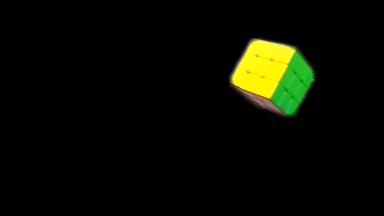

frame:1


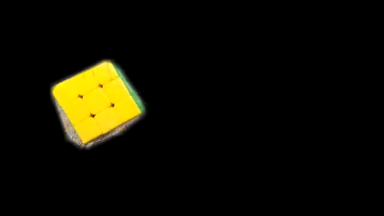

frame:2


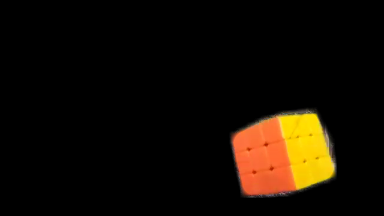

frame:3


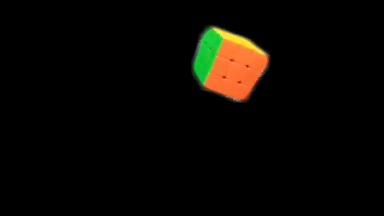

frame:4


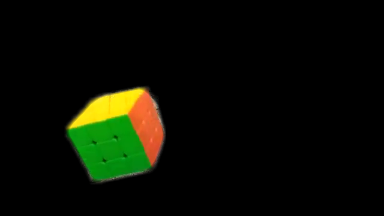

frame:5


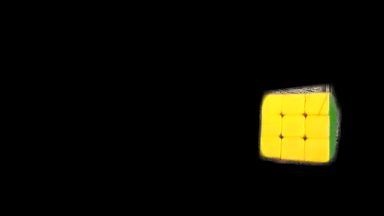

frame:6


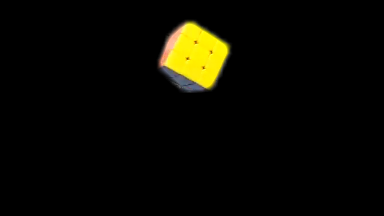

In [240]:
#inUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/cuboPend2.mp4'
inUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/cuboChao.mp4'
outUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/teste.webm'
saida = None
x = 0
i = 0
cap = openVideo(inUrl)

while True:
    ret, atualFrame = cap.read()
    if ret: 
        atualFrame = cv.resize(atualFrame, (384, 216))
        orig = atualFrame.copy()
        atualFrame = convexHullMask(atualFrame, binary=True)

        atualFrame = cv.erode(atualFrame, None, iterations=5)
        atualFrame = cv.blur(atualFrame, (12,12))
        atualFrame = cv.convertScaleAbs(atualFrame, atualFrame, 3, 0)

        # como bitwise_and, só que para contínuo
        atualFrame = (orig * (dim3(atualFrame)/255)).astype('uint8')

        if saida == None:
            saida = newVideo(outUrl, atualFrame)
        saida.write(atualFrame)

        if (x % 40) == 0:
            print (f"frame:{i}")
            show(atualFrame) 
            i = i + 1
        x = x + 1
    else: break

cap.release()
saida.release()

In [241]:
%cd '/content/drive/MyDrive/((UFABC))/(proc video)/'
%cp teste.webm /usr/local/share/jupyter/nbextensions/teste.webm

/content/drive/MyDrive/((UFABC))/(proc video)


In [242]:
%%html
<video controls>
    <source src='nbextensions/teste.webm'>
</video>

# Abordagem 3 - absdiff


`cv.absdiff` compara dois frames e retorna as mudanças de cada quadro. 
Apesar de parecer intuitivo que uma boa extração de background passe por capturar a diferença entre a imagem com o objeto e a imagem sem o objeto, a transição entre os frames durante o movimento de um objeto com areas de mesma cor faz com que esta técnica detecte buracos no meio do objeto. Já tínhamos resolvido este problema na versão com convexHull (abordagens 1 e 2). Vários experimentos foram feitos neste caso, com a utilização de máscaras e contornos sem sucesso. No entanto, o efeito 'neon' obtido pela diferença de posição dos objetos sobrepostos me pareceu promissor (para outros efeitos)

frame count: 418.0
width, height, fps: 640 352 29.73480537218302
frame:0


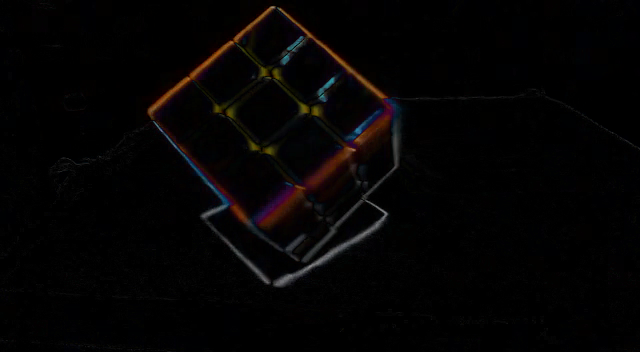

frame:1


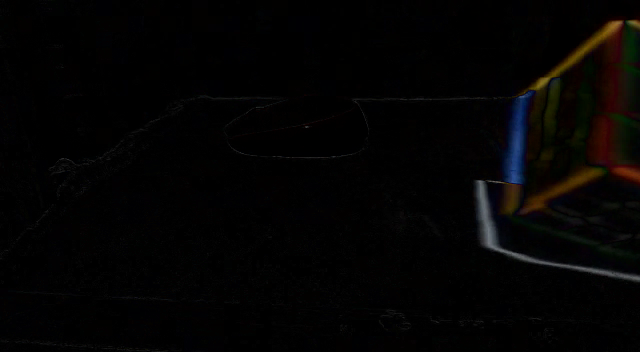

frame:2


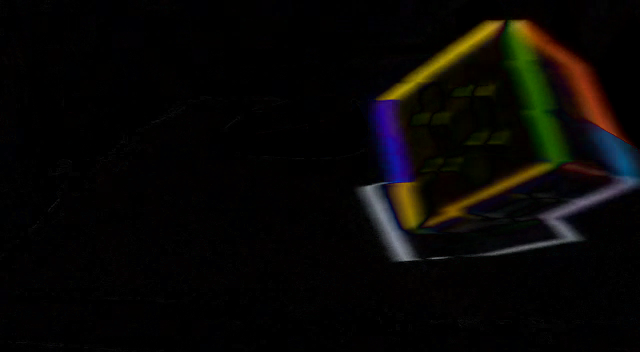

frame:3


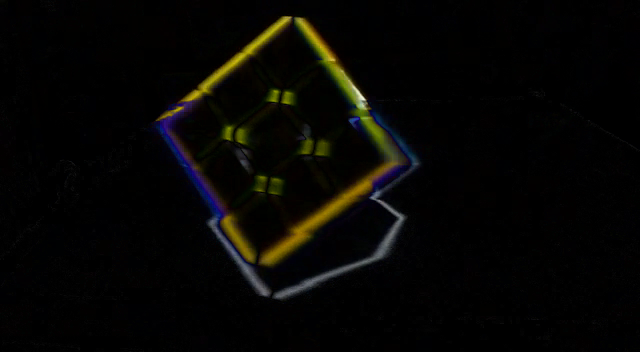

frame:4


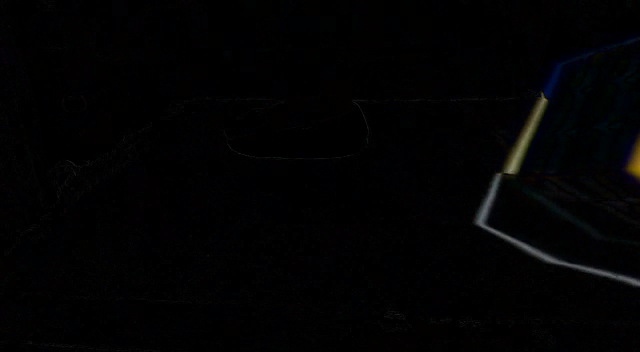

frame:5


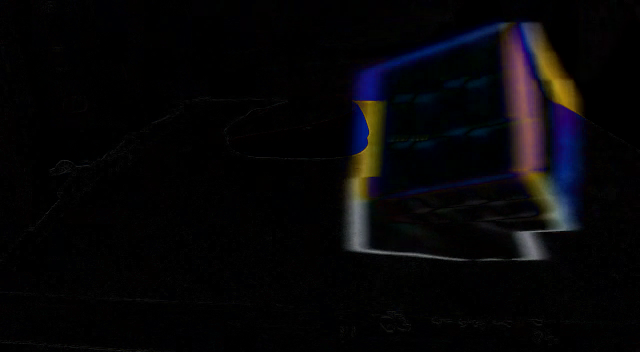

frame:6


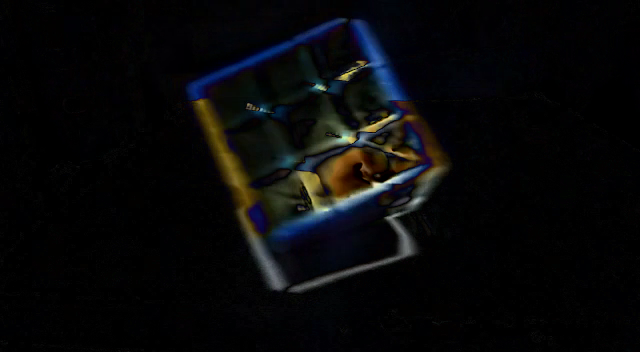

frame:7


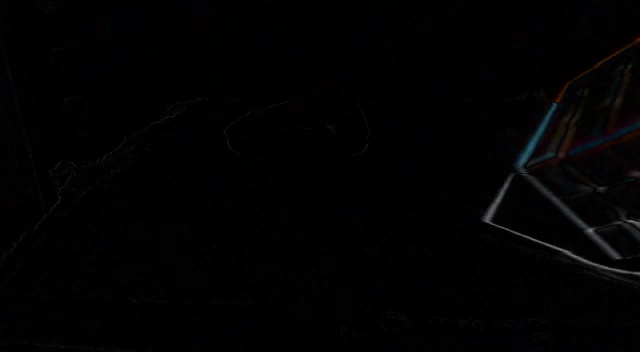

frame:8


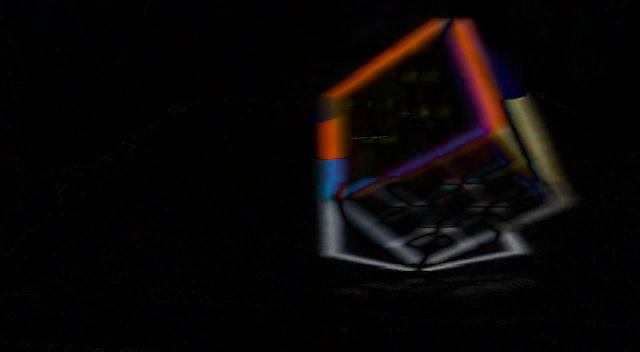

frame:9


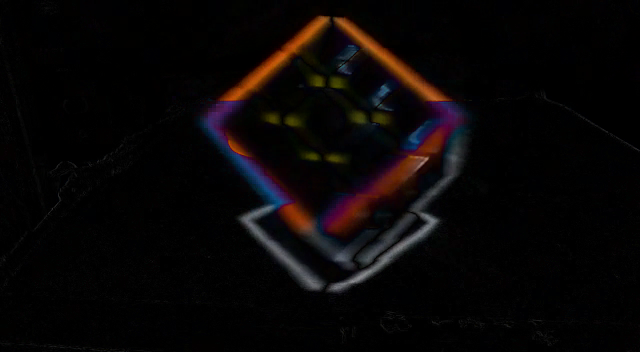

frame:10


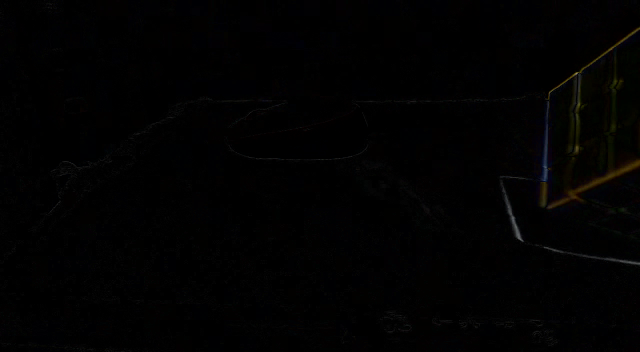

frame:11


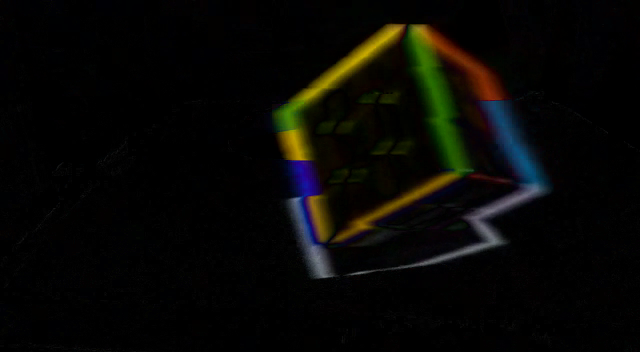

frame:12


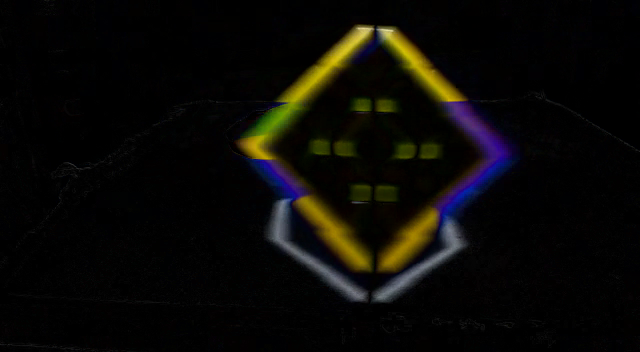

frame:13


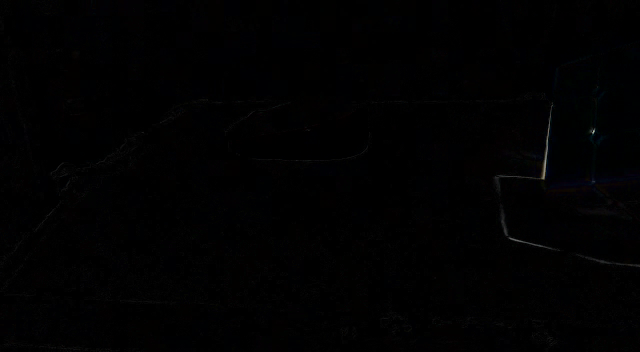

frame:14


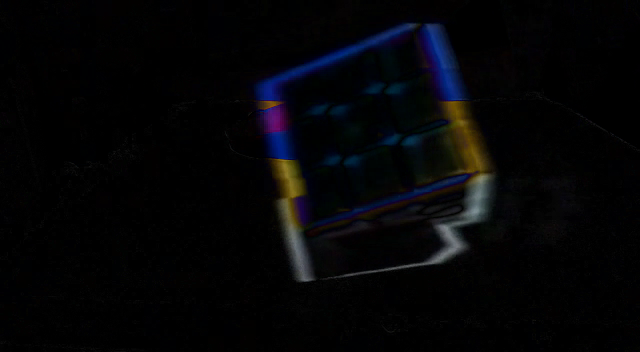

frame:15


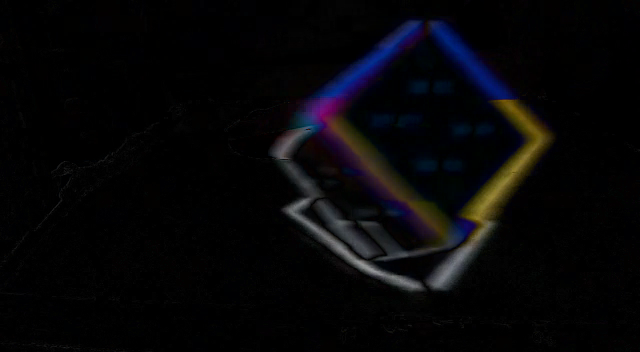

frame:16


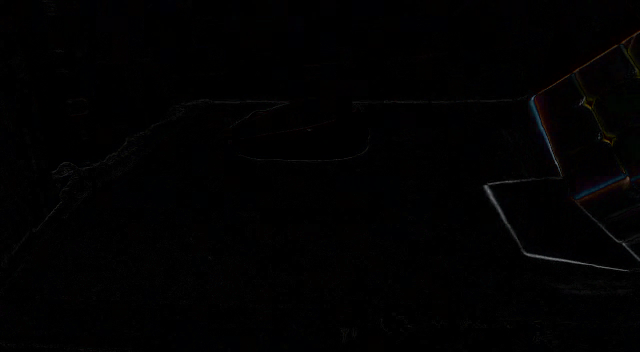

frame:17


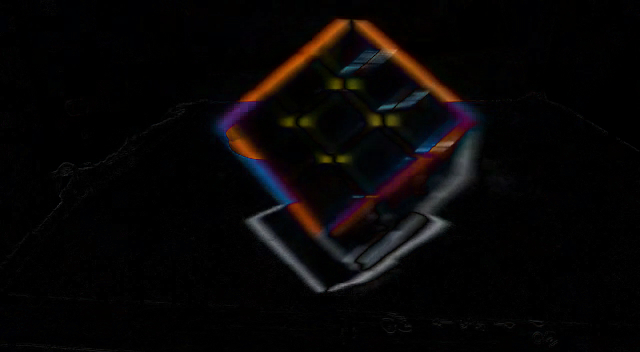

frame:18


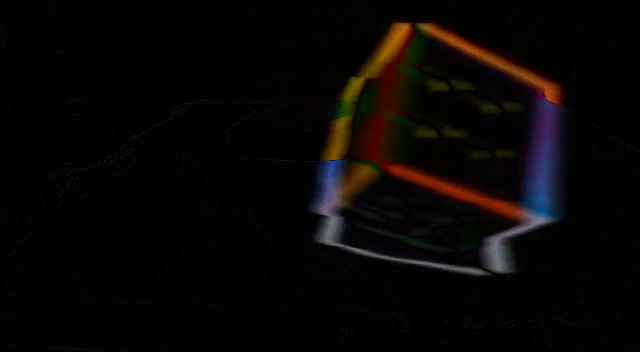

frame:19


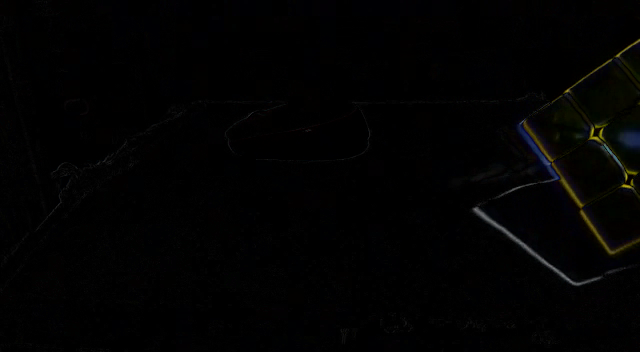

frame:20


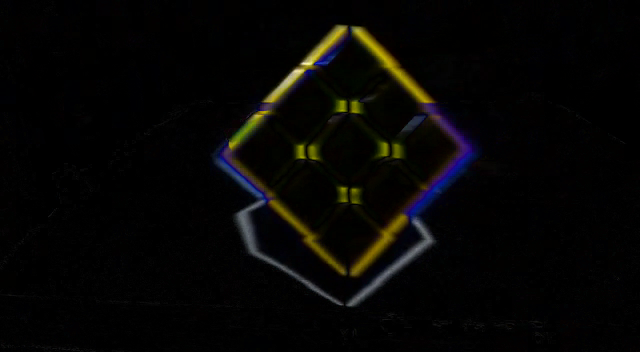

In [250]:
inUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/cuboPend2.mp4'
#inUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/cuboChao.mp4'
outUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/teste.webm'
saida = None
x = 0
i = 0
cap = openVideo(inUrl)

ret, frame = cap.read()
while True:
    ret, frame2 = cap.read()
    if ret: 
        frameOrig = cv.resize(frame, (384, 216))
        atualFrame = cv.absdiff(frame, frame2)

        if saida == None: 
            saida = newVideo(outUrl, atualFrame, 'vp80')
        saida.write(dim3(atualFrame))

        if (x % 20) == 0:
            print (f"frame:{i}")
            show(atualFrame) 
            i = i + 1
        x = x + 1
        frame = frame2.copy()
    else: break

cap.release()
saida.release()

In [251]:
%cd '/content/drive/MyDrive/((UFABC))/(proc video)/'
%cp teste.webm /usr/local/share/jupyter/nbextensions/teste.webm

/content/drive/MyDrive/((UFABC))/(proc video)


In [252]:
%%html
<video controls>
    <source src='nbextensions/teste.webm'>
</video>

<video controls>
    <source src='nbextensions/teste2.webm'>
</video>

# Abordagem 4 - createBackgroundSubtractor


Depois de muitos testes, estes são os dois algorirmos com melhores resultados. Deixo aqui uma comparação deles no mesmo video

frame count: 418.0
width, height, fps: 640 352 29.73480537218302
frame:0


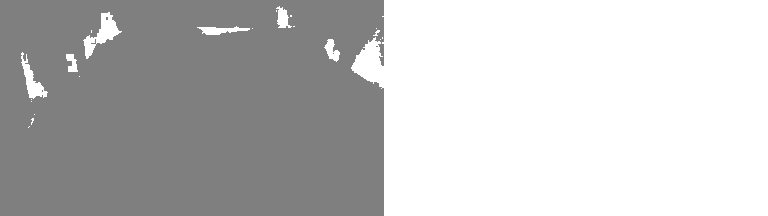

frame:1


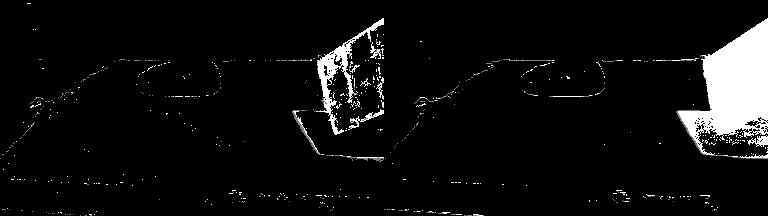

frame:2


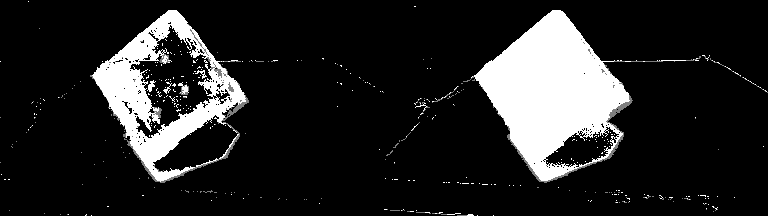

frame:3


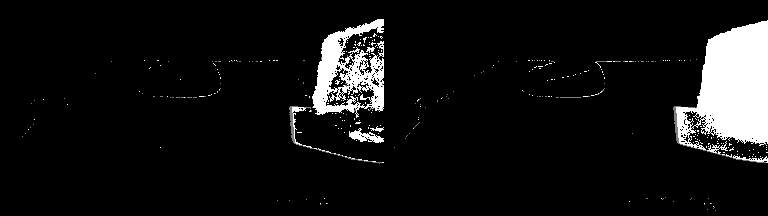

frame:4


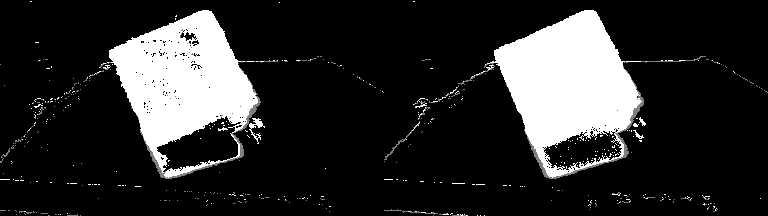

frame:5


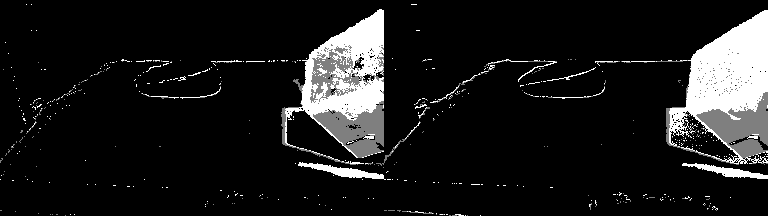

frame:6


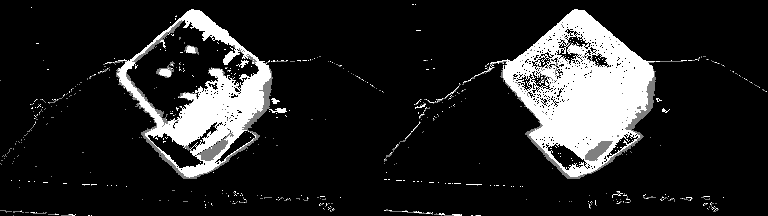

frame:7


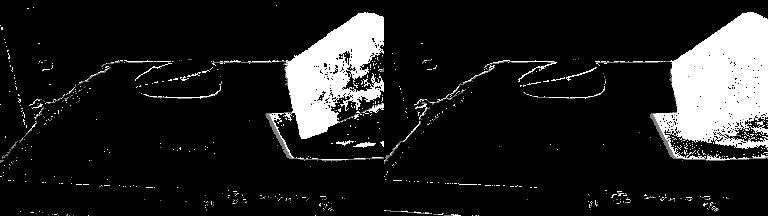

frame:8


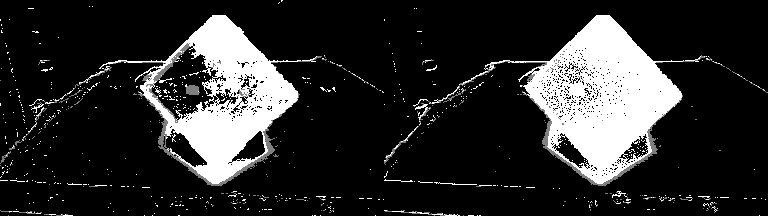

frame:9


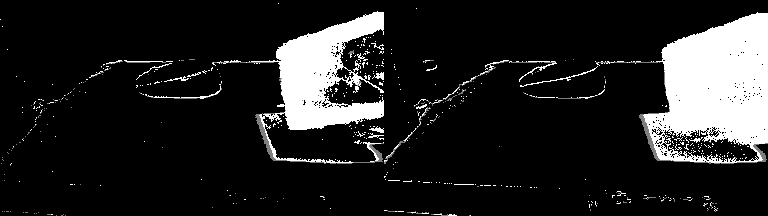

frame:10


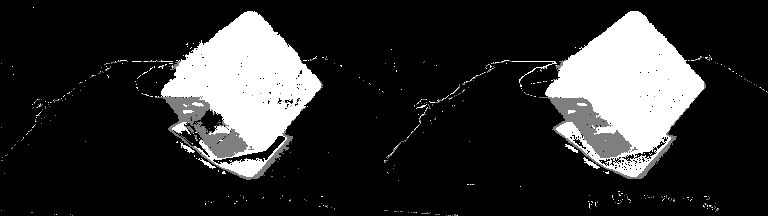

frame:11


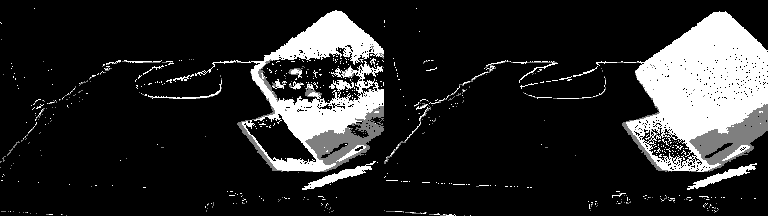

frame:12


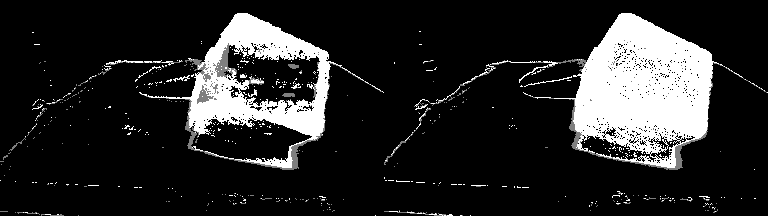

frame:13


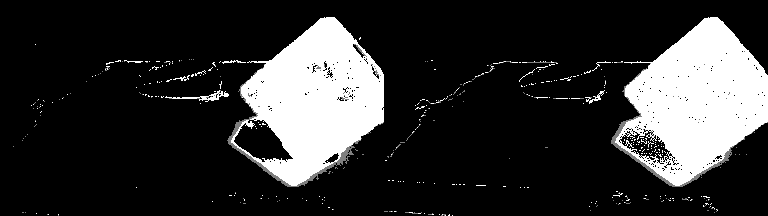

In [271]:
inUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/cuboPend2.mp4'
outUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/teste.webm'
saida = None
 
backSub1 = cv.createBackgroundSubtractorMOG2()
backSub2 = cv.createBackgroundSubtractorKNN()

x = 0
i = 0
frames = []
cap = openVideo(inUrl)

while True:
    ret, atualFrame = cap.read()
    if ret: 
        atualFrame = cv.resize(atualFrame, (384, 216))
        frame1 = backSub1.apply(atualFrame)
        frame2 = backSub2.apply(atualFrame)
        atualFrame = hstack(frame1, frame2)

        if saida == None: 
            saida = newVideo(outUrl, atualFrame)
        saida.write(atualFrame)

        if (x % 30) == 0:
            print (f"frame:{i}")
            frames.append(atualFrame)
            show(atualFrame) 
            i = i + 1
        x = x + 1
    else: break

cap.release()
saida.release()

In [272]:
%cd '/content/drive/MyDrive/((UFABC))/(proc video)/'
%cp teste.webm /usr/local/share/jupyter/nbextensions/teste.webm

/content/drive/MyDrive/((UFABC))/(proc video)


In [273]:
%%html
<video controls>
    <source src='nbextensions/teste.webm'>
</video>

# Abordagem 4b - createBackgroundSubtractorKNN


Uma vez escolhida a versão KNN que define um membro do grupo a partir de uma espécie de votação na vizinhança, vamos tentar melhorar aquela imagem fornecida pelo algoritmo. 

frame count: 418.0
width, height, fps: 640 352 29.73480537218302
frame:0


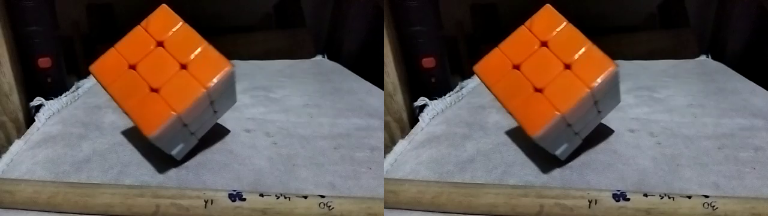

frame:1


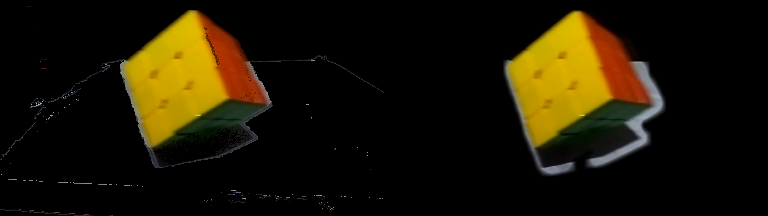

frame:2


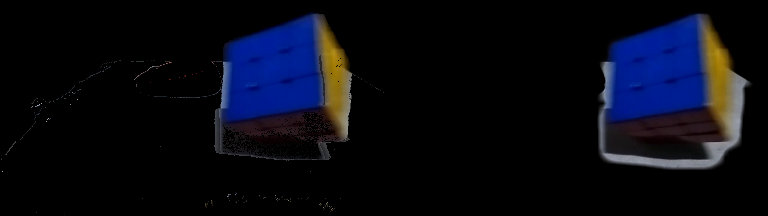

frame:3


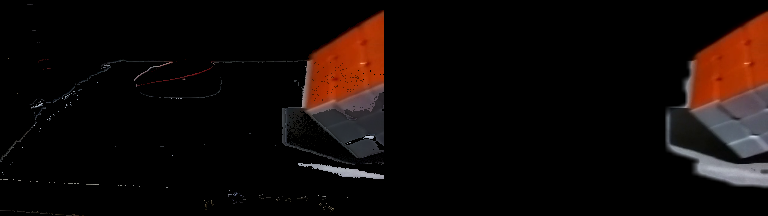

frame:4


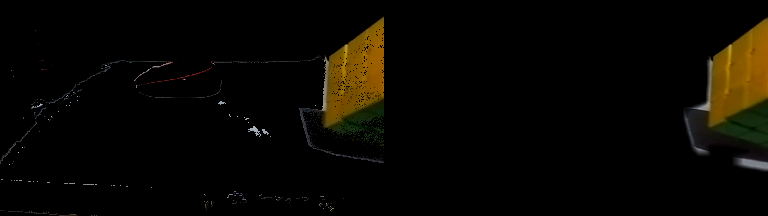

frame:5


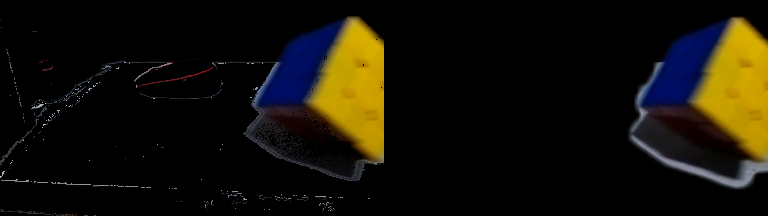

frame:6


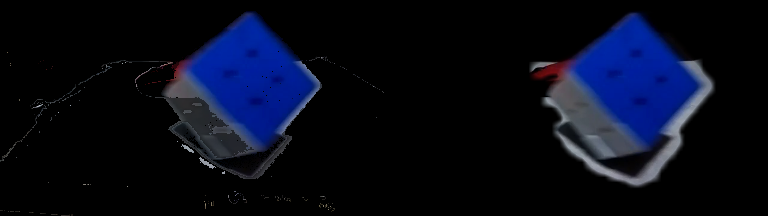

frame:7


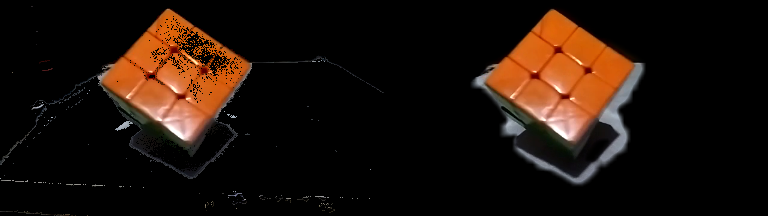

frame:8


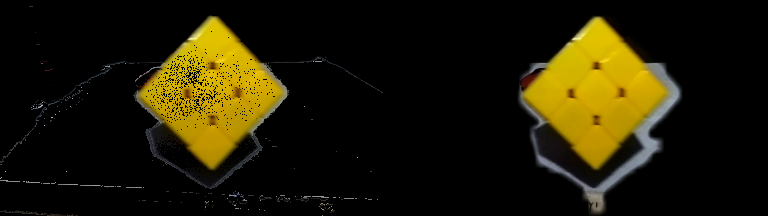

In [299]:
def MaskClose(img, k=10, iterations=1):
    kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(k, k))    
    img = cv.morphologyEx(img, cv.MORPH_CLOSE, kernel, iterations=iterations)
    return img

def MaskOpen(img, k=10, iterations=1):
    kernel = cv.getStructuringElement(cv.MORPH_ELLIPSE,(k, k))    
    img = cv.morphologyEx(img, cv.MORPH_OPEN, kernel, iterations=iterations)
    return img

def getS(img, bin=True):
    hsv = cv.cvtColor(img, cv.COLOR_BGR2HSV)
    h, s, v = cv.split(hsv)
    if bin: return v
    return dim3(v)

def refine(img, orig, close=1, closeIter=1, open=1, openIter=1):
    img = MaskClose(img, close, closeIter)
    img = MaskOpen(img, open, openIter)

    contours, _ = cv.findContours(img, cv.RETR_LIST, cv.CHAIN_APPROX_SIMPLE)
    img = np.zeros_like(img)
    cont = max(contours, key=cv.contourArea)
    cv.drawContours(img, [cont] , 0, 255, -1)
    img = cv.blur(img, (12,12))
    img = cv.convertScaleAbs(img, img, 3, 0)

    img = (orig * (dim3(img)/255)).astype('uint8')

    return img


inUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/cuboPend2.mp4'
outUrl = '/content/drive/MyDrive/((UFABC))/(proc video)/teste.webm'
saida = None
 
backSub = cv.createBackgroundSubtractorKNN()

x = 0
i = 0
frames = []
cap = openVideo(inUrl)

while True:
    ret, atualFrame = cap.read()
    if ret: 
        atualFrame = cv.resize(atualFrame, (384, 216))
        orig = atualFrame.copy()
        atualFrame = backSub.apply(atualFrame)

        img = (orig * (dim3(atualFrame)/255)).astype('uint8')

        atualFrame = hstack(img, refine(atualFrame, orig, 4, 3, 4, 1))

        if saida == None: 
            saida = newVideo(outUrl, atualFrame)
        saida.write(atualFrame)

        if (x % 50) == 0:
            print (f"frame:{i}")
            frames.append(atualFrame)
            show(atualFrame) 
            i = i + 1
        x = x + 1
    else: break

cap.release()
saida.release()

In [300]:
%cd '/content/drive/MyDrive/((UFABC))/(proc video)/'
%cp teste.webm /usr/local/share/jupyter/nbextensions/teste.webm

/content/drive/MyDrive/((UFABC))/(proc video)


In [301]:
%%html
<video controls>
    <source src='nbextensions/teste.webm'>
</video>

Não ficou bom. Os ajustes são difíceis e específicos para cada caso. Mas já são 16h20 e eu preciso enviar logo o relatório. 

# REFERÊNCIAS



* Motion Detection OpenCV Python <br> 
https://divyanshushekhar.com/motion-detection-opencv/

* Motion Analysis <br> 
https://docs.opencv.org/4.5.2/de/de1/group__video__motion.html

* BackGround Extraction using Running Average  ($\color{#DD0000}{\text{não deu tempo}}$)<br> 
http://opencvpython.blogspot.com/2012/07/background-extraction-using-running.html

*   Color spaces in OpenCV (C++ / Python) <BR>
https://learnopencv.com/color-spaces-in-opencv-cpp-python/

*   Morphological Transformations (OpenCV doc) <br>
https://docs.opencv.org/4.5.2/d9/d61/tutorial_py_morphological_ops.html
    
* OpenCV Object Detection Using Color segmentation (video) <br>
https://www.youtube.com/watch?v=efWITgemKvs

* Mathematical morphology <br>
https://en.wikipedia.org/wiki/Mathematical_morphology



